In [1]:
import torch
import torch.nn as nn
import torch.utils.model_zoo as model_zoo
import torch.nn.functional as F

from resnet_features import resnet18_features, resnet34_features, resnet50_features, resnet101_features, resnet152_features
from densenet_features import densenet121_features, densenet161_features, densenet169_features, densenet201_features
from vgg_features import vgg11_features, vgg11_bn_features, vgg13_features, vgg13_bn_features, vgg16_features, vgg16_bn_features,\
                         vgg19_features, vgg19_bn_features

from receptive_field import compute_proto_layer_rf_info_v2

from settings import img_size

from PIL import Image
import numpy as np
import numpy.random as npr
import pandas as pd
import os
import matplotlib.pyplot as plt
import torch.utils.data
# import torch.utils.data.distributed
import torchvision.transforms as transforms
import torchvision.datasets as datasets
import torch.optim as optim

import pickle as pkl
import skimage as sk
import skimage.io as skio
from preference_model import construct_PrefNet, paired_cross_entropy_loss, PrefNet

# book keeping namings and code
from settings import base_architecture, img_size, prototype_shape, num_classes, \
                     prototype_activation_function, add_on_layers_type, experiment_run

from preprocess import mean, std, preprocess_input_function
from tqdm import tqdm

In [54]:
csv_name = "./human_comparisons/rating_1000_0.csv"
assert os.path.exists(csv_name)
comp_df = pd.read_csv(csv_name)

In [55]:
base_architecture_to_features = {'resnet18': resnet18_features,
                                 'resnet34': resnet34_features,
                                 'resnet50': resnet50_features,
                                 'resnet101': resnet101_features,
                                 'resnet152': resnet152_features,
                                 'densenet121': densenet121_features,
                                 'densenet161': densenet161_features,
                                 'densenet169': densenet169_features,
                                 'densenet201': densenet201_features,
                                 'vgg11': vgg11_features,
                                 'vgg11_bn': vgg11_bn_features,
                                 'vgg13': vgg13_features,
                                 'vgg13_bn': vgg13_bn_features,
                                 'vgg16': vgg16_features,
                                 'vgg16_bn': vgg16_bn_features,
                                 'vgg19': vgg19_features,
                                 'vgg19_bn': vgg19_bn_features}


class PrefNet(nn.Module):

    def __init__(self, img_features, pattern_features, img_size, prototype_shape,
                 proto_layer_rf_info, num_classes, init_weights=False,
                 prototype_activation_function='log',
                 add_on_layers_type='bottleneck', 
                k = 1):

        super(PrefNet, self).__init__()
        self.img_size = img_size
        self.prototype_shape = prototype_shape
        self.num_prototypes = prototype_shape[0]
        self.num_classes = num_classes
        self.epsilon = 1e-4
        self.k = k
        
        # this has to be named features to allow the precise loading
        self.img_features = img_features
        self.pattern_features = pattern_features
        
        '''
        features_name = str(self.features).upper()
        if features_name.startswith('VGG') or features_name.startswith('RES'):
            first_add_on_layer_in_channels = \
                [i for i in features.modules() if isinstance(i, nn.Conv2d)][-1].out_channels
        elif features_name.startswith('DENSE'):
            first_add_on_layer_in_channels = \
                [i for i in features.modules() if isinstance(i, nn.BatchNorm2d)][-1].num_features
        else:
            raise Exception('other base base_architecture NOT implemented')
        '''
        
        '''    
        if add_on_layers_type == 'bottleneck':
            add_on_layers = []
            current_in_channels = first_add_on_layer_in_channels
            while (current_in_channels > self.prototype_shape[1]) or (len(add_on_layers) == 0):
                current_out_channels = max(self.prototype_shape[1], (current_in_channels // 2))
                add_on_layers.append(nn.Conv2d(in_channels=current_in_channels,
                                               out_channels=current_out_channels,
                                               kernel_size=1))
                add_on_layers.append(nn.ReLU())
                add_on_layers.append(nn.Conv2d(in_channels=current_out_channels,
                                               out_channels=current_out_channels,
                                               kernel_size=1))
                if current_out_channels > self.prototype_shape[1]:
                    add_on_layers.append(nn.ReLU())
                else:
                    assert(current_out_channels == self.prototype_shape[1])
                    add_on_layers.append(nn.Sigmoid())
                current_in_channels = current_in_channels // 2
            self.add_on_layers = nn.Sequential(*add_on_layers)
        else:
            self.add_on_layers = nn.Sequential(
                nn.Conv2d(in_channels=first_add_on_layer_in_channels, out_channels=self.prototype_shape[1], kernel_size=1),
                nn.ReLU(),
                nn.Conv2d(in_channels=self.prototype_shape[1], out_channels=self.prototype_shape[1], kernel_size=1),
                nn.Sigmoid()
                )
        
        '''
                
#         self.prototype_vectors = nn.Parameter(torch.rand(self.prototype_shape),
#                                               requires_grad=True)

#         # do not make this just a tensor,
#         # since it will not be moved automatically to gpu
#         self.ones = nn.Parameter(torch.ones(self.prototype_shape),
#                                  requires_grad=False)

#         self.last_layer = nn.Linear(self.num_prototypes, self.num_classes,
#                                     bias=False) # do not use bias
    

        self.img_conv = nn.Sequential(
            nn.Conv2d(in_channels=2048, out_channels=512, kernel_size=5),
            nn.ReLU(),
            nn.Conv2d(in_channels=512, out_channels=128, kernel_size=3),
            nn.Sigmoid()
            )
        
        self.pattern_conv = nn.Sequential(
            nn.Conv2d(in_channels=2048, out_channels=512, kernel_size=5),
            nn.ReLU(),
            nn.Conv2d(in_channels=512, out_channels=128, kernel_size=3),
            nn.Sigmoid()
            )
        
        self.final_fc = nn.Sequential(
            nn.Linear(256, 32),
            nn.ReLU(),
            nn.Sigmoid(),
            nn.Linear(32, 1),
            nn.Sigmoid()
        
            )
        
        #self.fc1 = nn.Linear(6400, 512)
        #self.fc2 = nn.Linear(512, 32)
        #self.fc3 = nn.Linear(32, 1)
        #self.fc1 = nn.Linear(64, 16)
        

        if init_weights:
            self._initialize_weights()
            
            
    def conv_features(self, x):
        '''
        the feature input to prototype layer
        '''
        # Insert k and then img size
        x = self.features(x)
        #print("base features: ", x.shape)
        #x = self.add_on_layers(x)
        return x
    
    def forward(self, x, p):
        
        x = self.img_features(x)
        x = self.img_conv(x)
        
        p = self.pattern_features(p)
        p = self.pattern_conv(p)
        
        out = torch.cat((x, p), dim=1)
        out = torch.flatten(out, 1) 
        out = self.final_fc(out)
        
        return out

    
    def _initialize_weights(self):
        for m in self.img_conv.modules():
            if isinstance(m, nn.Conv2d):
                # every init technique has an underscore _ in the name
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')

                if m.bias is not None:
                    nn.init.constant_(m.bias, 0)

            elif isinstance(m, nn.BatchNorm2d):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)
                
        for m in self.pattern_conv.modules():
            if isinstance(m, nn.Conv2d):
                # every init technique has an underscore _ in the name
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')

                if m.bias is not None:
                    nn.init.constant_(m.bias, 0)

            elif isinstance(m, nn.BatchNorm2d):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)




            
def construct_PrefNet(base_architecture, pretrained=True, img_size=224,
                    prototype_shape=(1000, 128, 1, 1), num_classes=200,
                    prototype_activation_function='log',
                    add_on_layers_type='bottleneck',
                    k = 1):
    img_features = base_architecture_to_features[base_architecture](pretrained=pretrained)
    pattern_features = base_architecture_to_features[base_architecture](pretrained=pretrained)
    layer_filter_sizes, layer_strides, layer_paddings = img_features.conv_info()
    proto_layer_rf_info = compute_proto_layer_rf_info_v2(img_size=img_size,
                                                         layer_filter_sizes=layer_filter_sizes,
                                                         layer_strides=layer_strides,
                                                         layer_paddings=layer_paddings,
                                                         prototype_kernel_size=prototype_shape[2])
    return PrefNet(img_features=img_features,
                   pattern_features=pattern_features,
                 img_size=img_size,
                 prototype_shape=prototype_shape,
                 proto_layer_rf_info=proto_layer_rf_info,
                 num_classes=num_classes,
                 init_weights=True,
                 prototype_activation_function=prototype_activation_function,
                 add_on_layers_type=add_on_layers_type,
                 k = k)


def paired_cross_entropy_loss(out1, out2, targets):
    
    total_loss = 0
    for i in range(len(targets)):
        
        if targets[i] == -1:
            p1 = torch.exp(out1[i])/(torch.exp(out1[i]) + torch.exp(out2[i]))
            loss = - torch.log(p1)
        elif targets[i] == 1:
            p2 = torch.exp(out2[i])/(torch.exp(out1[i]) + torch.exp(out2[i]))
            loss = - torch.log(p2)

        else:
            p1 = torch.exp(out1[i])/(torch.exp(out1[i]) + torch.exp(out2[i]))
            p2 = torch.exp(out2[i])/(torch.exp(out1[i]) + torch.exp(out2[i]))
            loss = - (0.5*torch.log(p1) + 0.5*torch.log(p2))
            
        total_loss += loss
    return total_loss


In [56]:
'''
Select 700 from 1000 images
'''
pf_model = torch.load('./human_comparisons/pref_model_700_random_rating_split0.7_acc0.915.pth')
images = []
patterns = []
heatmaps = []
predicted_rewards = []
for i in tqdm(range(1200)):
    img = './human_comparisons/feedback_images/700_0/original_imgs/' + str(int(comp_df.iloc[i]['img_id'])) + '_' + str(int(comp_df.iloc[i]['p_id'])) + '.png'
    img = plt.imread(img)[:, :, :3]
    img = np.transpose(img, (2, 0, 1))
    images.append(torch.from_numpy(np.array([img])))
    pattern = './human_comparisons/feedback_images/700_0/patterns/' + str(int(comp_df.iloc[i]['img_id'])) + '_' + str(int(comp_df.iloc[i]['p_id'])) + '.npy'
    pattern = np.load(pattern)
    pattern = np.array([pattern, pattern, pattern])
    patterns.append(torch.from_numpy(np.array([pattern])))
    heatmap = plt.imread('./human_comparisons/feedback_images/700_0/heatmaps/' + str(int(comp_df.iloc[i]['img_id'])) + '_' + str(int(comp_df.iloc[i]['p_id'])) + '.png')
    heatmaps.append(heatmap[:, :, :3])
    reward = pf_model(torch.from_numpy(np.array([img])).cuda(), torch.from_numpy(np.array([pattern])).cuda()).detach().cpu().numpy()
    predicted_rewards.append(reward)
print(len(images))
print(images[10].shape)
print(patterns[10].shape)
print(heatmaps[10].shape)

100%|██████████| 1200/1200 [00:27<00:00, 43.18it/s]

1200
torch.Size([1, 3, 224, 224])
torch.Size([1, 3, 224, 224])
(224, 224, 3)


In [30]:
idx = 98
pf_model(images[idx].cuda(), patterns[idx].cuda())

tensor([[0.0178]], device='cuda:0', grad_fn=<SigmoidBackward0>)

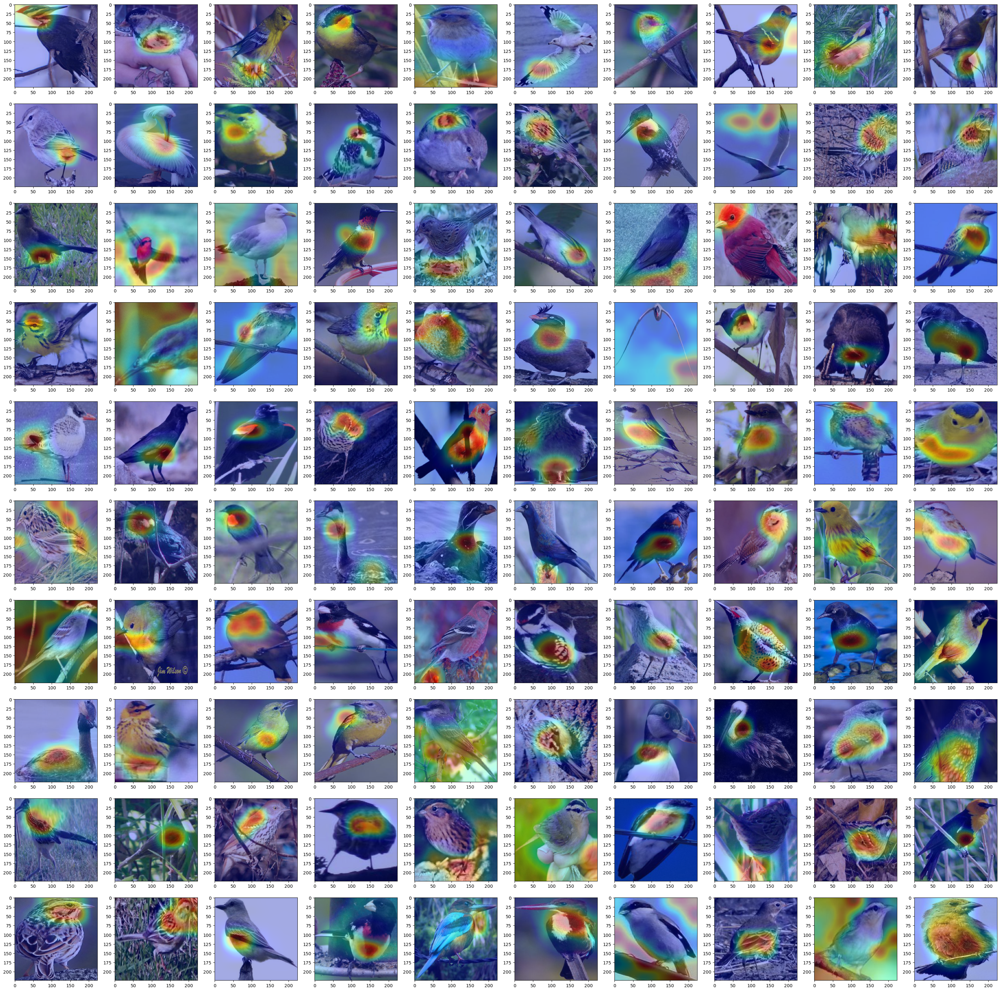

In [22]:
start_idx = 0
f, axarr = plt.subplots(10, 10, figsize=(40,40))
for i in range(10):
    for j in range(10):
        axarr[i][j].imshow(heatmaps[start_idx + i*10+j])

In [57]:
reward_values = [x[0][0] for x in predicted_rewards]

(array([429.,  23.,  19.,  19.,  22.,  24.,  21.,  19.,  27., 597.]),
 array([0.01784527, 0.11437701, 0.21090874, 0.30744049, 0.40397221,
        0.50050396, 0.59703571, 0.69356745, 0.79009914, 0.88663089,
        0.98316264]),
 <BarContainer object of 10 artists>)

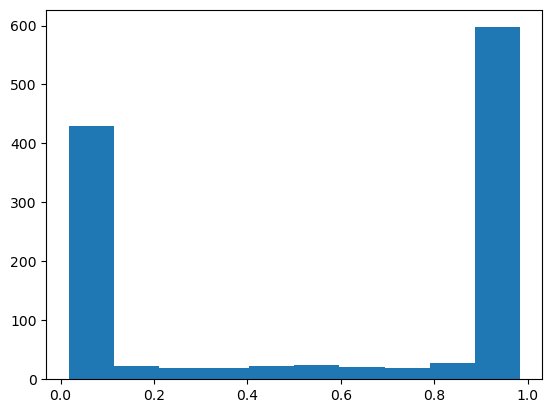

In [58]:
plt.hist(reward_values)

In [59]:
'''
Randomly delete popular values
'''
img_idx = [int(comp_df.iloc[i]['img_id']) for i in range(1200)]
p_idx = [int(comp_df.iloc[i]['p_id']) for i in range(1200)]
num_deletes = 0
while num_deletes < 500:
    k = np.random.choice(1200 - num_deletes)
    if reward_values[k] < 0.11 or reward_values[k] > 0.885: 
        img_idx = np.delete(img_idx, [k])
        p_idx = np.delete(p_idx, [k])
        reward_values = np.delete(reward_values, [k])
        num_deletes += 1
print(len(img_idx), len(p_idx), len(reward_values))

700 700 700


In [60]:
csv_name = "./human_comparisons/rating_700_0.csv"
rating_df = pd.DataFrame({"img_id": img_idx, "p_id": p_idx, "rating: ": np.zeros(700)})
rating_df.to_csv(csv_name)

In [61]:
'''
Check the distribution of the selected samples
'''
images = []
patterns = []
heatmaps = []
predicted_rewards = []
for i in tqdm(range(700)):
    img = './human_comparisons/feedback_images/700_0/original_imgs/' + str(int(rating_df.iloc[i]['img_id'])) + '_' + str(int(rating_df.iloc[i]['p_id'])) + '.png'
    img = plt.imread(img)[:, :, :3]
    img = np.transpose(img, (2, 0, 1))
    images.append(torch.from_numpy(np.array([img])))
    pattern = './human_comparisons/feedback_images/700_0/patterns/' + str(int(rating_df.iloc[i]['img_id'])) + '_' + str(int(rating_df.iloc[i]['p_id'])) + '.npy'
    pattern = np.load(pattern)
    pattern = np.array([pattern, pattern, pattern])
    patterns.append(torch.from_numpy(np.array([pattern])))
    heatmap = plt.imread('./human_comparisons/feedback_images/700_0/heatmaps/' + str(int(rating_df.iloc[i]['img_id'])) + '_' + str(int(rating_df.iloc[i]['p_id'])) + '.png')
    heatmaps.append(heatmap[:, :, :3])
    reward = pf_model(torch.from_numpy(np.array([img])).cuda(), torch.from_numpy(np.array([pattern])).cuda()).detach().cpu().numpy()
    predicted_rewards.append(reward)
print(len(images))
print(images[10].shape)
print(patterns[10].shape)
print(heatmaps[10].shape)

100%|██████████| 700/700 [00:16<00:00, 42.90it/s]

700
torch.Size([1, 3, 224, 224])
torch.Size([1, 3, 224, 224])
(224, 224, 3)


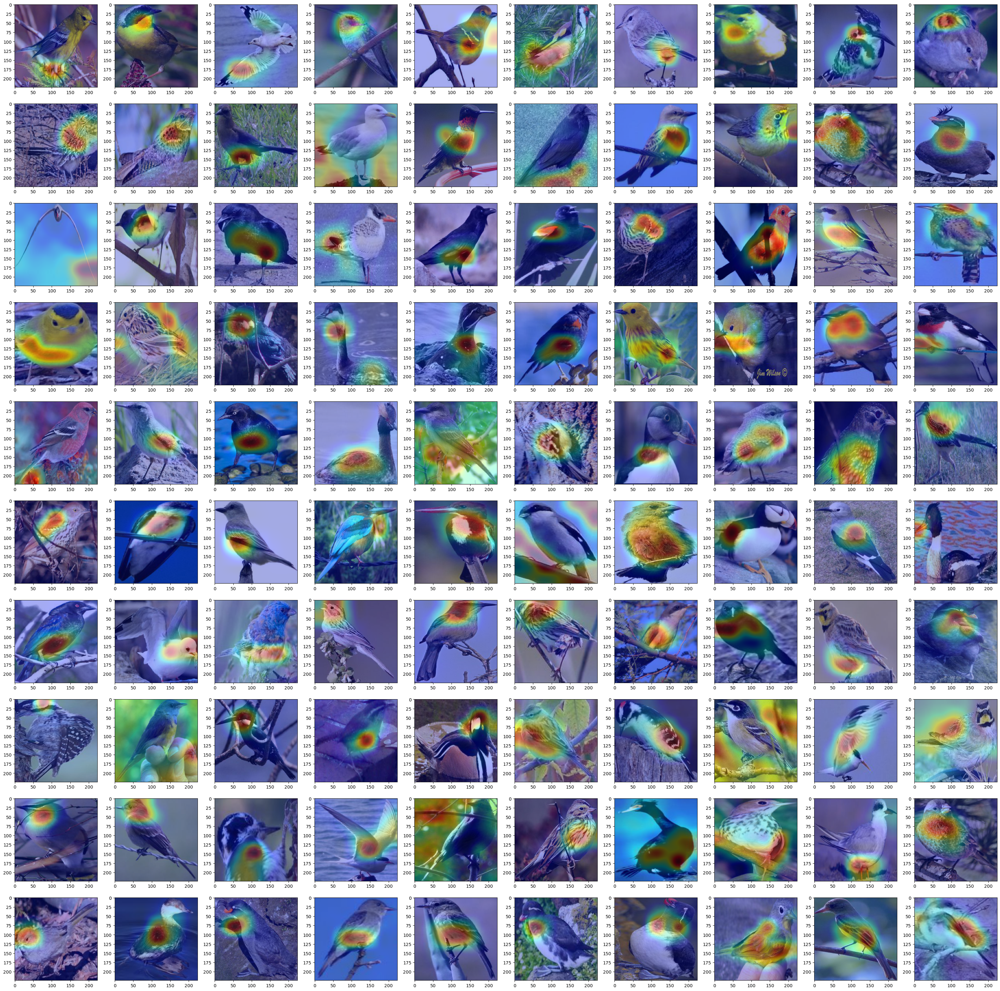

In [62]:
start_idx = 0
f, axarr = plt.subplots(10, 10, figsize=(40,40))
for i in range(10):
    for j in range(10):
        axarr[i][j].imshow(heatmaps[start_idx + i*10+j])

(array([214.,  23.,  19.,  19.,  22.,  24.,  21.,  19.,  27., 312.]),
 array([0.01784527, 0.11437687, 0.21090849, 0.3074401 , 0.4039717 ,
        0.5005033 , 0.59703493, 0.6935665 , 0.79009813, 0.8866297 ,
        0.98316133]),
 <BarContainer object of 10 artists>)

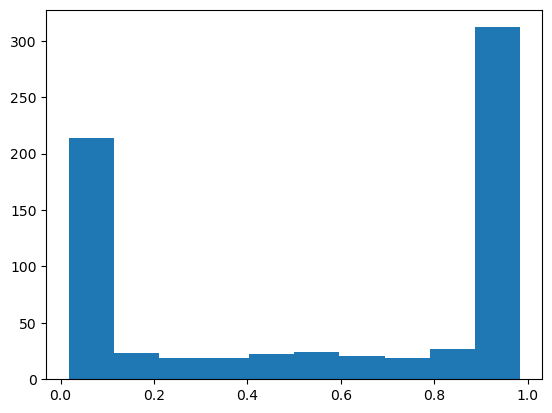

In [63]:
reward_values = [x[0][0] for x in predicted_rewards]
plt.hist(reward_values)

In [67]:
'''
Visualize heatmaps of intermediate predicted values
'''
middle_idx = [i for i in range(700) if (reward_values[i] > 0.11 and reward_values[i] < 0.885)]
print(len(middle_idx), middle_idx)

174 [4, 8, 9, 10, 11, 18, 21, 25, 26, 30, 34, 37, 43, 44, 49, 56, 64, 67, 69, 79, 82, 86, 87, 90, 91, 94, 100, 103, 113, 114, 121, 122, 123, 124, 127, 128, 130, 136, 141, 143, 150, 151, 152, 155, 164, 166, 168, 173, 179, 180, 181, 184, 198, 200, 206, 218, 221, 224, 227, 229, 230, 242, 243, 245, 249, 255, 257, 267, 268, 273, 280, 281, 285, 295, 296, 303, 313, 317, 324, 332, 336, 341, 347, 355, 361, 364, 369, 370, 372, 373, 374, 376, 378, 385, 389, 396, 398, 402, 403, 404, 405, 410, 412, 419, 422, 425, 427, 428, 442, 447, 453, 456, 465, 466, 467, 468, 471, 472, 476, 479, 481, 485, 486, 490, 491, 492, 493, 501, 502, 504, 507, 528, 531, 538, 539, 555, 559, 567, 568, 569, 571, 581, 584, 585, 590, 593, 596, 597, 598, 603, 606, 609, 623, 627, 630, 632, 634, 640, 651, 653, 656, 657, 662, 664, 668, 671, 675, 679, 682, 683, 684, 694, 695, 696]


In [68]:
print([reward for reward in reward_values if reward > 0.11 and reward < 0.885])

[0.40826106, 0.8641338, 0.36193907, 0.5650561, 0.369447, 0.8255347, 0.33915666, 0.7861622, 0.13385046, 0.38255653, 0.21463239, 0.85876155, 0.38822883, 0.6983574, 0.4817296, 0.18560421, 0.7181053, 0.8702606, 0.26439175, 0.39137113, 0.8524616, 0.5674425, 0.69754773, 0.48449698, 0.7459556, 0.8173705, 0.50744087, 0.6393137, 0.8756833, 0.26439708, 0.76712257, 0.83266914, 0.45684674, 0.384928, 0.77255845, 0.34660497, 0.75585383, 0.5262342, 0.43810132, 0.4907534, 0.65535975, 0.33383295, 0.57136756, 0.4453944, 0.27409747, 0.670187, 0.25252864, 0.23552018, 0.8255966, 0.118330255, 0.81422746, 0.8437092, 0.82034236, 0.4527701, 0.21625881, 0.8749003, 0.70134515, 0.62652767, 0.52027833, 0.3895724, 0.8014099, 0.74181557, 0.81356907, 0.6308954, 0.64179695, 0.5226693, 0.743358, 0.30844325, 0.25037372, 0.72350824, 0.81769264, 0.24918732, 0.5857461, 0.3262928, 0.44607243, 0.19103575, 0.1560597, 0.66042453, 0.66101736, 0.5058614, 0.8217259, 0.43413633, 0.26395395, 0.40732875, 0.17280038, 0.42313734, 0.37